### 1. Imports e Configuração Global

In [ ]:
# Imports Essenciais
import os
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torchvision import transforms, datasets
import matplotlib.pyplot as plt
import numpy as np
import json
import copy
from google.colab import drive
from sklearn.metrics import accuracy_score

# Montar o Google Drive
drive.mount('/content/drive')

# Definição de Caminhos e Parâmetros
project_path = '/content/drive/MyDrive/MVTec_Anomaly_Detection'
CHOSEN_CATEGORY = 'bottle'
dataset_root = os.path.join(project_path, 'datasets', CHOSEN_CATEGORY)
train_dir = os.path.join(dataset_root, 'train')
test_dir = os.path.join(dataset_root, 'test')

# Configurações do Modelo e Treinamento
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
IMG_SIZE = 256
BATCH_SIZE = 16
LEARNING_RATE = 1e-4 # Um learning rate um pouco menor é bom para modelos mais complexos
EPOCHS = 200 # Limite máximo, o Early Stopping provavelmente vai parar antes
PATIENCE_LIMIT = 10 # Um pouco mais de paciência para o modelo maior

print(f"Dispositivo: {DEVICE}")
print(f"Categoria: {CHOSEN_CATEGORY}")
print("Configuração inicial concluída.")

Mounted at /content/drive
Dispositivo: cuda
Categoria: bottle
Configuração inicial concluída.


### 2. Preparação dos Dados (com Aumentação)

In [ ]:
# --- TRANSFORMAÇÕES ---
# Transformações para o treino (com aumentação)
train_transforms = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.RandomHorizontalFlip(p=0.5),           # Espelha a imagem horizontalmente com 50% de chance
    transforms.RandomRotation(10),                   # Rotaciona a imagem em até 10 graus
    transforms.ColorJitter(brightness=0.1, contrast=0.1), # Altera brilho e contraste
    transforms.ToTensor(),
])

# Transformações para validação e teste (sem aumentação)
val_test_transforms = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
])


# --- DATASETS ---

# Carrega o dataset de treino completo para obter os índices
# Usaremos o dataset sem transformações para a validação para garantir consistência
full_train_dataset_for_split = datasets.ImageFolder(root=train_dir, transform=val_test_transforms)

# Divide os índices em 90% para treino e 10% para validação
train_size = int(0.9 * len(full_train_dataset_for_split))
val_size = len(full_train_dataset_for_split) - train_size
train_indices, val_indices = torch.utils.data.random_split(range(len(full_train_dataset_for_split)), [train_size, val_size])

# Cria um novo dataset de treino com os índices de treino e as transformações de AUMENTAÇÃO
train_dataset_augmented = datasets.ImageFolder(root=train_dir, transform=train_transforms)
train_subset = torch.utils.data.Subset(train_dataset_augmented, train_indices)

# Cria o subset de validação com os índices de validação e as transformações NORMAIS
val_subset = torch.utils.data.Subset(full_train_dataset_for_split, val_indices)

# O dataset de teste, também com transformações NORMAIS
test_dataset = datasets.ImageFolder(root=test_dir, transform=val_test_transforms)


# --- DATALOADERS ---
train_loader = DataLoader(dataset=train_subset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(dataset=val_subset, batch_size=BATCH_SIZE, shuffle=False)
test_loader = DataLoader(dataset=test_dataset, batch_size=BATCH_SIZE, shuffle=False)

print(f"Dados prontos:")
print(f" - Imagens de Treino: {len(train_subset)}")
print(f" - Imagens de Validação: {len(val_subset)}")
print(f" - Imagens de Teste: {len(test_dataset)}")

Dados prontos:
 - Imagens de Treino: 188
 - Imagens de Validação: 21
 - Imagens de Teste: 83


### 3. Definição do Modelo U-Net

In [ ]:
# Bloco de construção básico para a U-Net: (Conv -> BN -> ReLU) * 2
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
        )
    def forward(self, x):
        return self.conv(x)

# A arquitetura U-Net completa
class UNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=3, features=[64, 128, 256, 512]):
        super(UNet, self).__init__()
        self.encoder = nn.ModuleList()
        self.decoder = nn.ModuleList()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        # Parte Codificadora (Encoder)
        for feature in features:
            self.encoder.append(DoubleConv(in_channels, feature))
            in_channels = feature

        # Parte Decodificadora (Decoder)
        for feature in reversed(features):
            self.decoder.append(nn.ConvTranspose2d(feature * 2, feature, kernel_size=2, stride=2))
            self.decoder.append(DoubleConv(feature * 2, feature))

        # Camada mais profunda (bottleneck)
        self.bottleneck = DoubleConv(features[-1], features[-1] * 2)
        # Camada final para ajustar a saída para 3 canais (RGB)
        self.final_conv = nn.Conv2d(features[0], out_channels, kernel_size=1)

    def forward(self, x):
        skip_connections = []

        # Passagem pelo Encoder
        for down in self.encoder:
            x = down(x)
            skip_connections.append(x)
            x = self.pool(x)

        x = self.bottleneck(x)
        skip_connections = skip_connections[::-1] # Inverte para usar no decoder

        # Passagem pelo Decoder
        for idx in range(0, len(self.decoder), 2):
            x = self.decoder[idx](x) # Upsampling
            skip_connection = skip_connections[idx // 2]

            # Concatena a saída do decoder com o "atalho" (skip connection)
            concat_skip = torch.cat((skip_connection, x), dim=1)
            x = self.decoder[idx + 1](concat_skip) # DoubleConv

        x = self.final_conv(x)
        return torch.sigmoid(x) # Sigmoid para garantir saída entre 0 e 1

# Instancia o modelo e o envia para o dispositivo (GPU/CPU)
model = UNet().to(DEVICE)

# Imprime a arquitetura para verificação
print("Arquitetura U-Net definida e instanciada:")
# print(model) # Descomente esta linha se quiser ver a lista completa de camadas

Arquitetura U-Net definida e instanciada:


### 4. Treinamento do Modelo U-Net

In [ ]:
# --- FERRAMENTAS E PARÂMETROS DE TREINAMENTO ---
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)
training_history = []

# --- LÓGICA DO EARLY STOPPING ---
best_val_loss = float('inf')
patience_counter = 0
best_model_state = None

print(f"Iniciando treinamento com Early Stopping (Paciência = {PATIENCE_LIMIT})...")

# --- LOOP DE TREINAMENTO ---
for epoch in range(EPOCHS):
    # --- FASE DE TREINO ---
    model.train()
    train_epoch_loss = 0.0
    for data in train_loader:
        images, _ = data
        images = images.to(DEVICE)
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, images)
        loss.backward()
        optimizer.step()
        train_epoch_loss += loss.item()
    avg_train_loss = train_epoch_loss / len(train_loader)

    # --- FASE DE VALIDAÇÃO ---
    model.eval()
    val_epoch_loss = 0.0
    with torch.no_grad():
        for data in val_loader:
            images, _ = data
            images = images.to(DEVICE)
            outputs = model(images)
            loss = criterion(outputs, images)
            val_epoch_loss += loss.item()
    avg_val_loss = val_epoch_loss / len(val_loader)

    # Guarda o histórico
    history_log = {"epoch": epoch + 1, "train_loss": avg_train_loss, "val_loss": avg_val_loss}
    training_history.append(history_log)
    print(f"Época [{epoch+1}/{EPOCHS}], Perda Treino: {avg_train_loss:.6f}, Perda Validação: {avg_val_loss:.6f}")

    # --- VERIFICAÇÃO DO EARLY STOPPING ---
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        patience_counter = 0
        best_model_state = copy.deepcopy(model.state_dict()) # Salva o estado do melhor modelo
        print(f"  -> Validação melhorou. Salvando estado do modelo.")
    else:
        patience_counter += 1
        print(f"  -> Validação não melhorou. Paciência: {patience_counter}/{PATIENCE_LIMIT}")

    if patience_counter >= PATIENCE_LIMIT:
        print("\nEarly stopping ativado! O treinamento foi interrompido.")
        break

print("\nTreinamento concluído!")

Iniciando treinamento com Early Stopping (Paciência = 10)...
Época [1/200], Perda Treino: 0.064892, Perda Validação: 0.117826
  -> Validação melhorou. Salvando estado do modelo.
Época [2/200], Perda Treino: 0.025041, Perda Validação: 0.066028
  -> Validação melhorou. Salvando estado do modelo.
Época [3/200], Perda Treino: 0.018263, Perda Validação: 0.033478
  -> Validação melhorou. Salvando estado do modelo.
Época [4/200], Perda Treino: 0.015181, Perda Validação: 0.022083
  -> Validação melhorou. Salvando estado do modelo.
Época [5/200], Perda Treino: 0.014292, Perda Validação: 0.017373
  -> Validação melhorou. Salvando estado do modelo.
Época [6/200], Perda Treino: 0.012150, Perda Validação: 0.014645
  -> Validação melhorou. Salvando estado do modelo.
Época [7/200], Perda Treino: 0.011644, Perda Validação: 0.013255
  -> Validação melhorou. Salvando estado do modelo.
Época [8/200], Perda Treino: 0.010011, Perda Validação: 0.012060
  -> Validação melhorou. Salvando estado do modelo.
Épo

### 5. Salvamentp

In [ ]:
# --- SALVAR HISTÓrico E MODELO ---
print("--- Salvando Resultados do Treinamento ---")

# Salvar Histórico
json_log_file = os.path.join(project_path, f'{CHOSEN_CATEGORY}_unet_history.json')
print(f"Salvando histórico em: {json_log_file}")
with open(json_log_file, 'w') as f:
    json.dump(training_history, f, indent=4)

# Salvar o melhor estado do Modelo
model_save_path = os.path.join(project_path, f'{CHOSEN_CATEGORY}_unet_best.pth')
if best_model_state:
    print(f"Salvando melhor modelo (da época 99) em: {model_save_path}")
    torch.save(best_model_state, model_save_path)
    # Carrega o melhor modelo para a avaliação logo abaixo
    model.load_state_dict(best_model_state)
else:
    print("Nenhum 'melhor estado' foi salvo. Usando o modelo da última época para avaliação.")


# --- AVALIAÇÃO NO CONJUNTO DE TESTE ---
print("\n--- Iniciando Avaliação no Conjunto de Teste ---")
model.eval() # Garante que o modelo está em modo de avaliação
reconstruction_errors = []
true_labels = []
with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(DEVICE)
        reconstructions = model(images)
        for i in range(len(images)):
            error = criterion(reconstructions[i], images[i]) # criterion foi definido na Célula 4
            reconstruction_errors.append(error.item())
            true_labels.append(labels[i].item())

print(f"{len(reconstruction_errors)} erros de reconstrução calculados.")

# Encontrar melhor threshold para o modelo U-Net
errors = np.array(reconstruction_errors)
labels = np.array(true_labels)
binary_labels = (labels > 0).astype(int)
best_accuracy = 0
best_threshold = 0
for threshold in np.linspace(np.min(errors), np.max(errors), num=1000):
    predictions = (errors > threshold).astype(int)
    accuracy = accuracy_score(binary_labels, predictions)
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_threshold = threshold

print("\n--- RESULTADO DA AVALIAÇÃO (U-NET) ---")
print(f"Melhor Threshold Encontrado: {best_threshold:.6f}")
print(f"Acurácia Final no Teste: {best_accuracy*100:.2f}%")

--- Salvando Resultados do Treinamento ---
Salvando histórico em: /content/drive/MyDrive/MVTec_Anomaly_Detection/bottle_unet_history.json
Salvando melhor modelo (da época 99) em: /content/drive/MyDrive/MVTec_Anomaly_Detection/bottle_unet_best.pth

--- Iniciando Avaliação no Conjunto de Teste ---
83 erros de reconstrução calculados.

--- RESULTADO DA AVALIAÇÃO (U-NET) ---
Melhor Threshold Encontrado: 0.000185
Acurácia Final no Teste: 74.70%


### 6. Visualização dos Resultados Finais

--- Gerando Visualizações com o Modelo U-Net ---
--- Exemplo de Imagem Normal ---


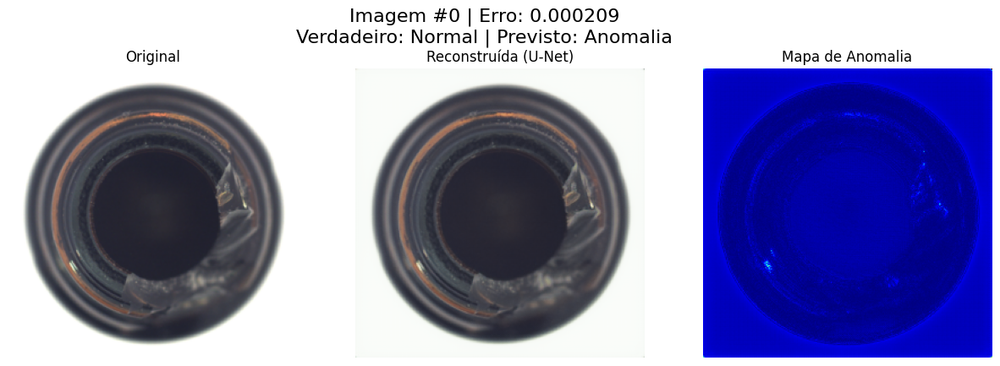


--- Exemplo de Imagem com Anomalia ---


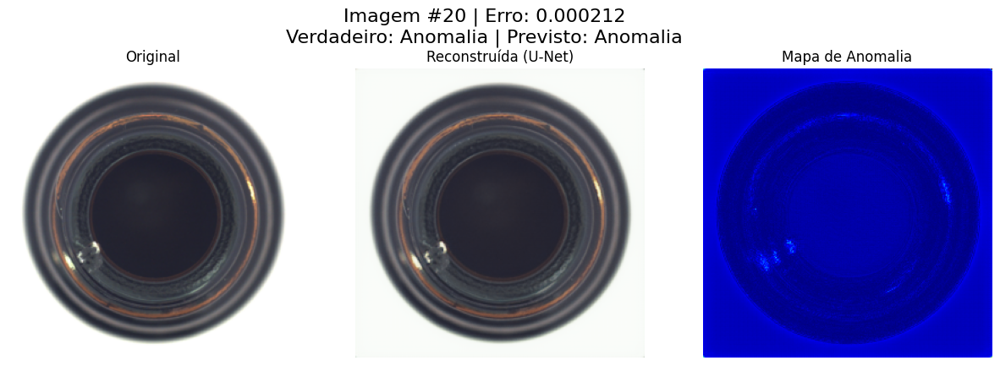

In [ ]:
# --- VISUALIZAÇÃO DOS RESULTADOS (U-NET) ---
print("--- Gerando Visualizações com o Modelo U-Net ---")

def visualize_predictions(dataset_indices):
    """
    Função para visualizar as previsões do modelo para índices específicos do dataset de teste.
    """
    # Garante que estamos usando o melhor modelo que foi carregado na célula anterior
    model.eval()

    for idx in dataset_indices:
        # Pega a imagem e a etiqueta original
        image, label = test_dataset[idx]
        image_tensor = image.unsqueeze(0).to(DEVICE)

        # Passa a imagem pelo modelo
        with torch.no_grad():
            reconstruction = model(image_tensor)

        # Calcula o mapa de anomalia (diferença) e converte para escala de cinza
        anomaly_map = torch.mean(torch.abs(image_tensor - reconstruction), dim=1, keepdim=True)

        # Pega o erro de reconstrução e a etiqueta que já calculamos na célula anterior
        error = errors[idx]
        true_label_str = "Anomalia" if binary_labels[idx] == 1 else "Normal"

        # Faz a previsão com base no nosso threshold
        prediction_str = "Anomalia" if error > best_threshold else "Normal"

        # Prepara imagens para plotagem
        original_img = image.permute(1, 2, 0).numpy()
        reconstructed_img = reconstruction.squeeze().cpu().permute(1, 2, 0).numpy()
        anomaly_map_img = anomaly_map.squeeze().cpu().numpy()

        # Plota os resultados
        fig, axs = plt.subplots(1, 3, figsize=(15, 5))
        fig.suptitle(f"Imagem #{idx} | Erro: {error:.6f}\nVerdadeiro: {true_label_str} | Previsto: {prediction_str}", fontsize=16)

        axs[0].imshow(original_img); axs[0].set_title("Original"); axs[0].axis('off')
        axs[1].imshow(reconstructed_img); axs[1].set_title("Reconstruída (U-Net)"); axs[1].axis('off')
        axs[2].imshow(anomaly_map_img, cmap='jet'); axs[2].set_title("Mapa de Anomalia"); axs[2].axis('off')
        plt.show()

# --- EXECUTA A VISUALIZAÇÃO ---
# Encontra o índice da primeira imagem Normal e da primeira com Anomalia no conjunto de teste
idx_normal = np.where(binary_labels == 0)[0][0]
idx_anomalia = np.where(binary_labels == 1)[0][0]

print("--- Exemplo de Imagem Normal ---")
visualize_predictions([idx_normal])
print("\n--- Exemplo de Imagem com Anomalia ---")
visualize_predictions([idx_anomalia])

Encontradas 20 imagens 'Normais' no conjunto de teste.
Gerando visualização para cada uma delas...
--------------------------------------------------


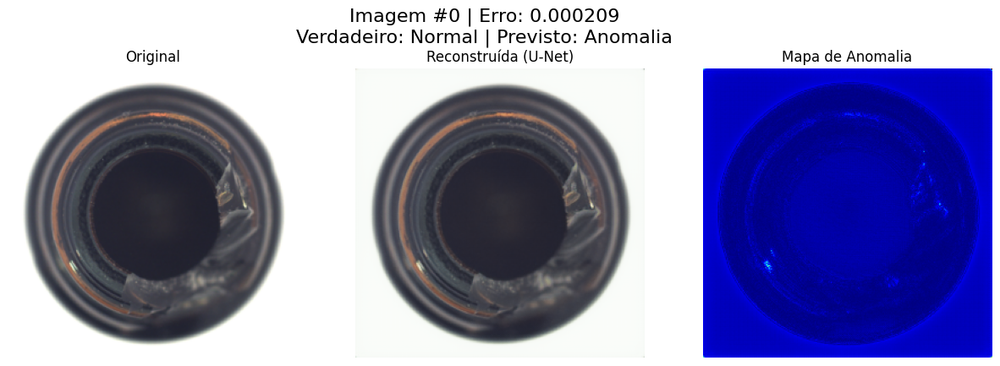

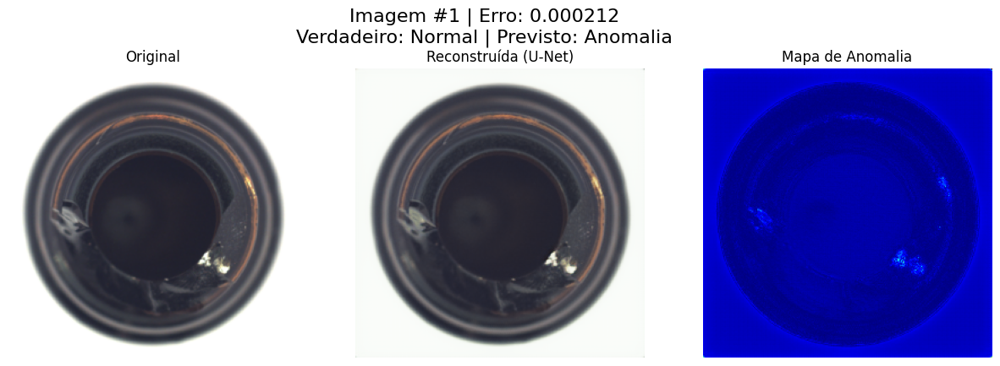

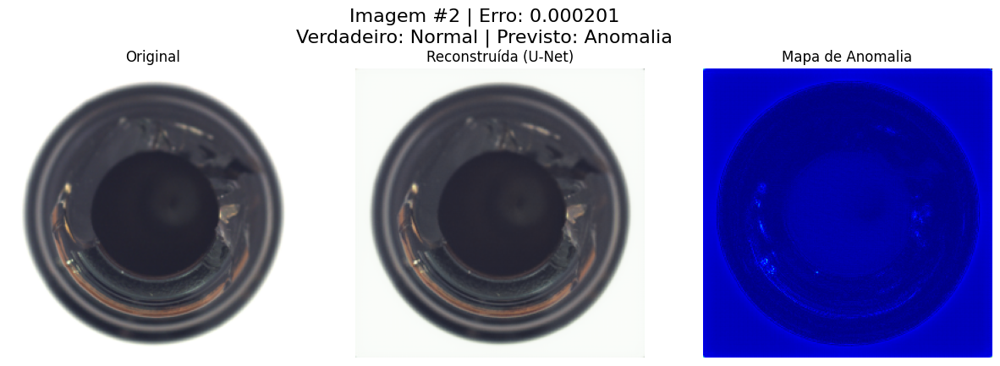

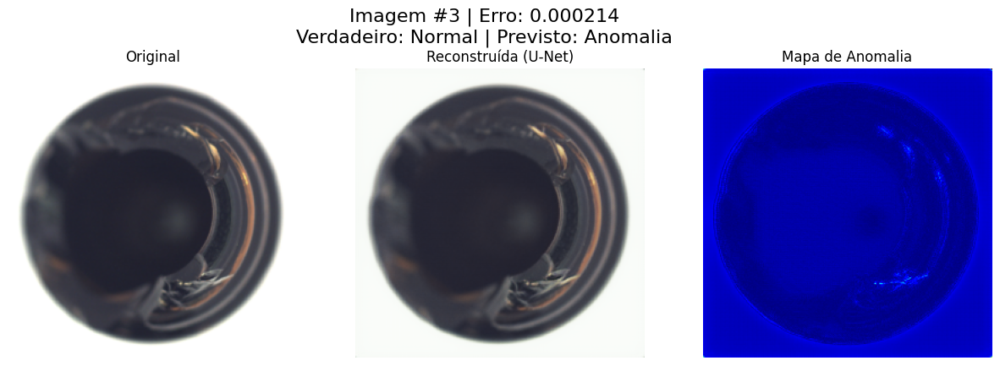

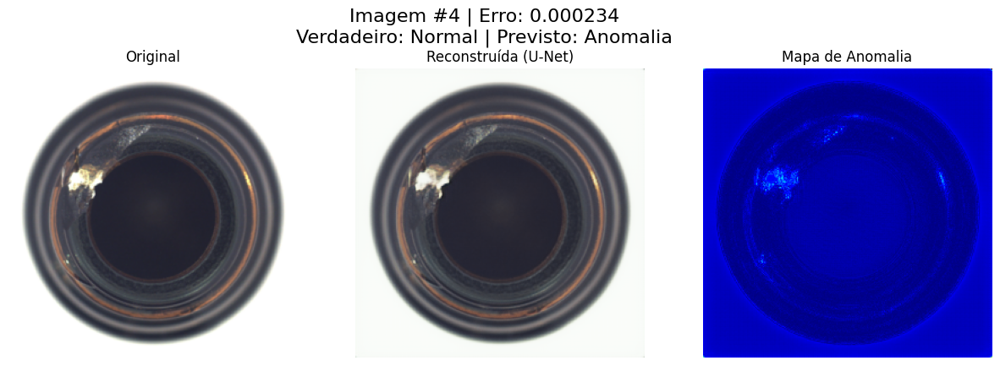

...

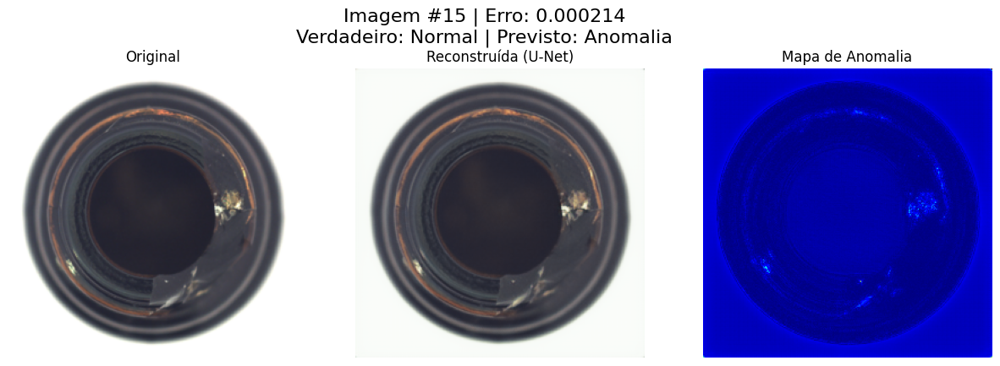

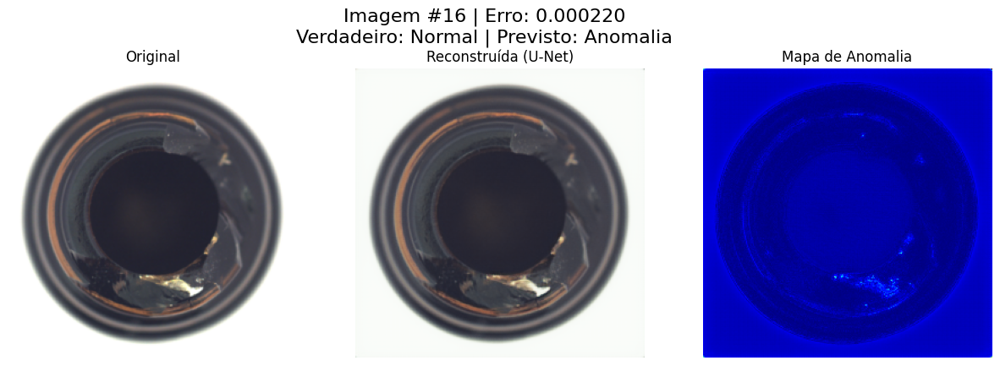

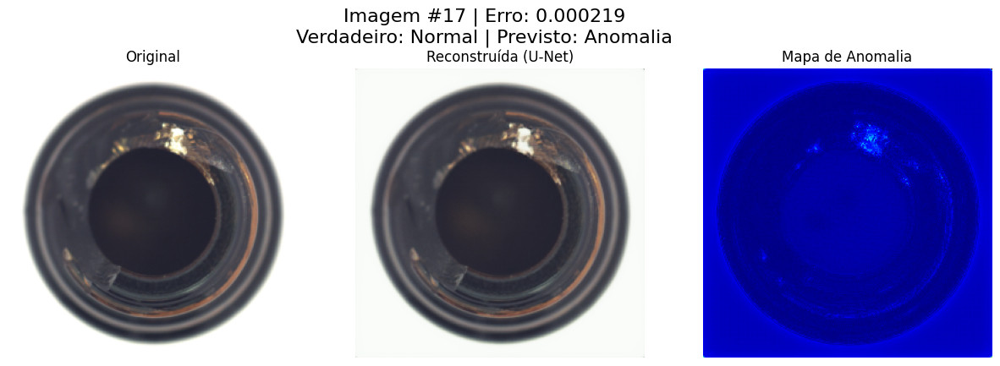

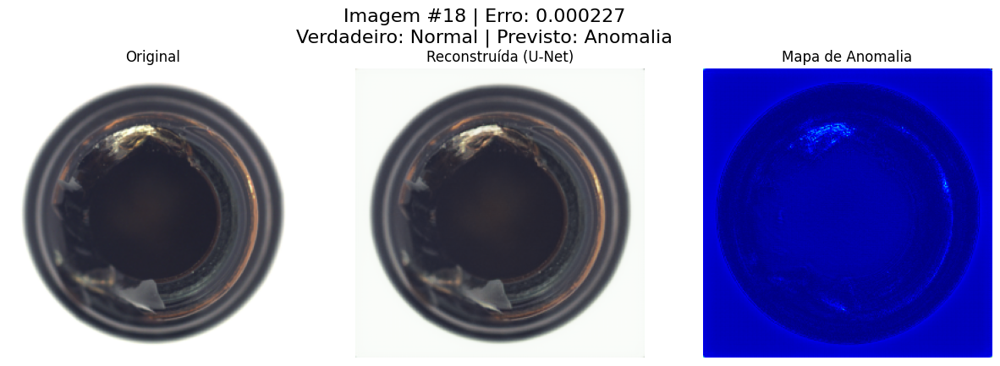

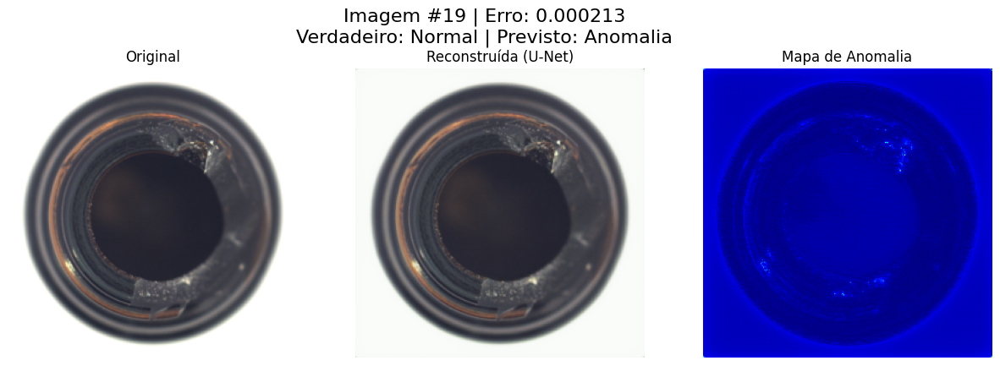

--------------------------------------------------
Visualização de todas as amostras normais concluída.


In [ ]:
# As variáveis `binary_labels` e a função `visualize_predictions`
# já existem das células anteriores.

# 1. Encontra os índices de todas as imagens rotuladas como "Normais" (label = 0)
indices_normais = np.where(binary_labels == 0)[0]

print(f"Encontradas {len(indices_normais)} imagens 'Normais' no conjunto de teste.")
print("Gerando visualização para cada uma delas...")
print("-" * 50)


# 2. Passa a lista completa de índices para a função de visualização
visualize_predictions(indices_normais)

print("-" * 50)
print("Visualização de todas as amostras normais concluída.")

--- Realizando o teste de sanidade com uma amostra do conjunto de treino ---


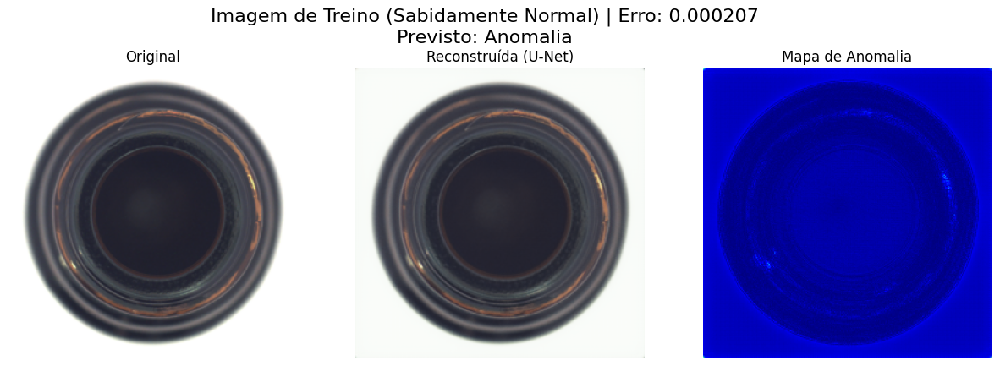

In [ ]:
print("--- Realizando o teste de sanidade com uma amostra do conjunto de treino ---")

# Carrega o dataset de treino (que só tem peças boas) com as transformações de teste (sem aumentação)
good_dataset = datasets.ImageFolder(root=train_dir, transform=val_test_transforms)

# Pega uma imagem de exemplo do dataset de treino
# Pode mudar o índice [15] para qualquer outro número se quiser ver outra imagem
image, label = good_dataset[15]
image_tensor = image.unsqueeze(0).to(DEVICE)

# --- Executa a avaliação para esta única imagem ---
model.eval()
with torch.no_grad():
    reconstruction = model(image_tensor)

# Calcula o erro e o mapa de anomalia
error = criterion(reconstruction, image_tensor)
anomaly_map = torch.mean(torch.abs(image_tensor - reconstruction), dim=1, keepdim=True)

# Faz a previsão com base no nosso threshold
prediction_str = "Anomalia" if error.item() > best_threshold else "Normal"

# Prepara imagens para plotagem
original_img = image.permute(1, 2, 0).numpy()
reconstructed_img = reconstruction.squeeze().cpu().permute(1, 2, 0).numpy()
anomaly_map_img = anomaly_map.squeeze().cpu().numpy()

# Plota os resultados
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
fig.suptitle(f"Imagem de Treino (Sabidamente Normal) | Erro: {error.item():.6f}\nPrevisto: {prediction_str}", fontsize=16)

axs[0].imshow(original_img); axs[0].set_title("Original"); axs[0].axis('off')
axs[1].imshow(reconstructed_img); axs[1].set_title("Reconstruída (U-Net)"); axs[1].axis('off')
axs[2].imshow(anomaly_map_img, cmap='jet'); axs[2].set_title("Mapa de Anomalia"); axs[2].axis('off')
plt.show()

--- Calculando um Threshold Estatisticamente Robusto ---
Erro médio nas imagens normais (μ): 0.000208
Desvio Padrão dos erros (σ): 0.000005
--------------------------------------------------
Threshold antigo (baseado em acurácia falha): 0.000185
NOVO THRESHOLD ESTATÍSTICO (μ + 3σ): 0.000224
--------------------------------------------------
--- Reavaliando a imagem de treino com o threshold correto ---


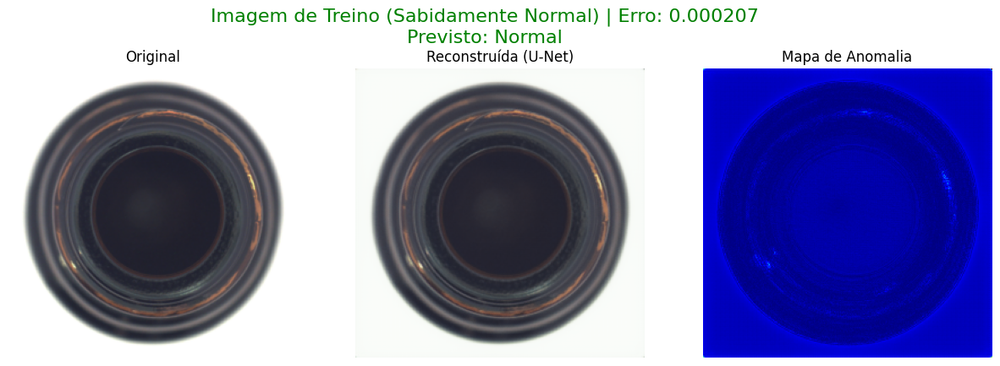

In [ ]:
print("--- Calculando um Threshold Estatisticamente Robusto ---")

# Vamos usar nosso val_loader, que só contém imagens normais e confiáveis.
model.eval()
val_errors = []
with torch.no_grad():
    for images, _ in val_loader:
        images = images.to(DEVICE)
        reconstructions = model(images)
        for i in range(len(images)):
            error = criterion(reconstructions[i], images[i])
            val_errors.append(error.item())

# Calcula a média e o desvio padrão dos erros das imagens normais
mean_error = np.mean(val_errors)
std_error = np.std(val_errors)

# Define o novo threshold (Média + 3 Desvios Padrão)
new_threshold = mean_error + 3 * std_error

print(f"Erro médio nas imagens normais (μ): {mean_error:.6f}")
print(f"Desvio Padrão dos erros (σ): {std_error:.6f}")
print("-" * 50)
print(f"Threshold antigo (baseado em acurácia falha): {best_threshold:.6f}")
print(f"NOVO THRESHOLD ESTATÍSTICO (μ + 3σ): {new_threshold:.6f}")
print("-" * 50)


# --- REAVALIANDO A IMAGEM NORMAL COM O NOVO THRESHOLD ---
print("--- Reavaliando a imagem de treino com o threshold correto ---")

# Pega a mesma imagem de antes
image, label = good_dataset[15]
image_tensor = image.unsqueeze(0).to(DEVICE)

# Re-calcula os dados dela
with torch.no_grad():
    reconstruction = model(image_tensor)
error = criterion(reconstruction, image_tensor)
anomaly_map = torch.mean(torch.abs(image_tensor - reconstruction), dim=1, keepdim=True)

# Faz a previsão com o NOVO threshold
prediction_str = "Anomalia" if error.item() > new_threshold else "Normal" # A MUDANÇA ESTÁ AQUI

# Plota os resultados
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
fig.suptitle(f"Imagem de Treino (Sabidamente Normal) | Erro: {error.item():.6f}\nPrevisto: {prediction_str}", fontsize=16, color='green')
axs[0].imshow(image.permute(1, 2, 0).numpy()); axs[0].set_title("Original"); axs[0].axis('off')
axs[1].imshow(reconstruction.squeeze().cpu().permute(1, 2, 0).numpy()); axs[1].set_title("Reconstruída (U-Net)"); axs[1].axis('off')
axs[2].imshow(anomaly_map.squeeze().cpu().numpy(), cmap='jet'); axs[2].set_title("Mapa de Anomalia"); axs[2].axis('off')
plt.show()

Encontradas 63 imagens rotuladas como 'Anomalia' no conjunto de teste.
Gerando visualização para cada uma delas usando o threshold estatístico...
--------------------------------------------------


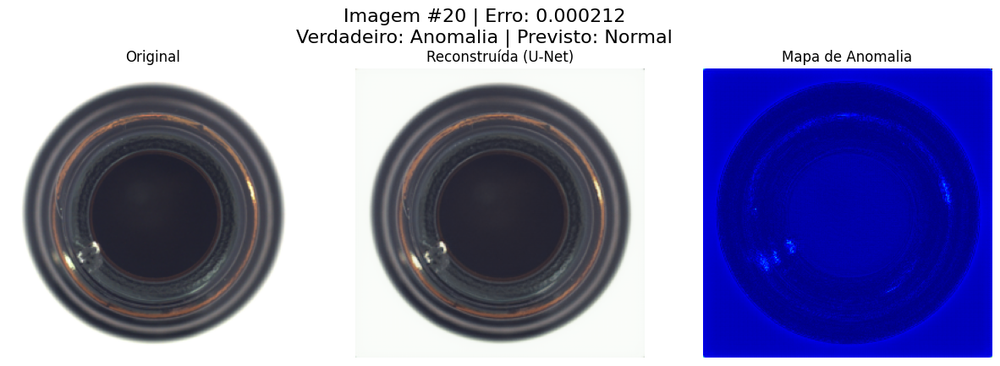

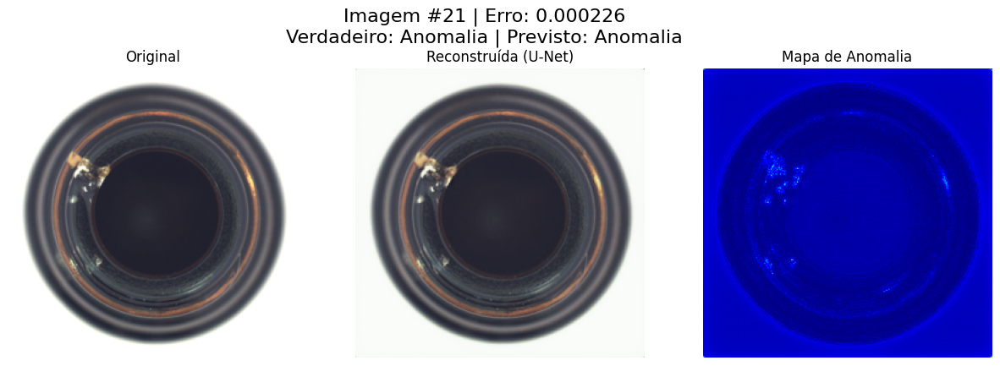

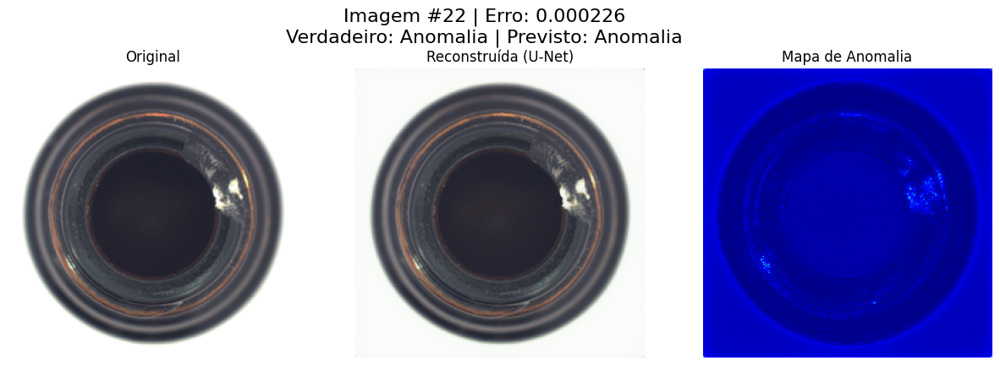

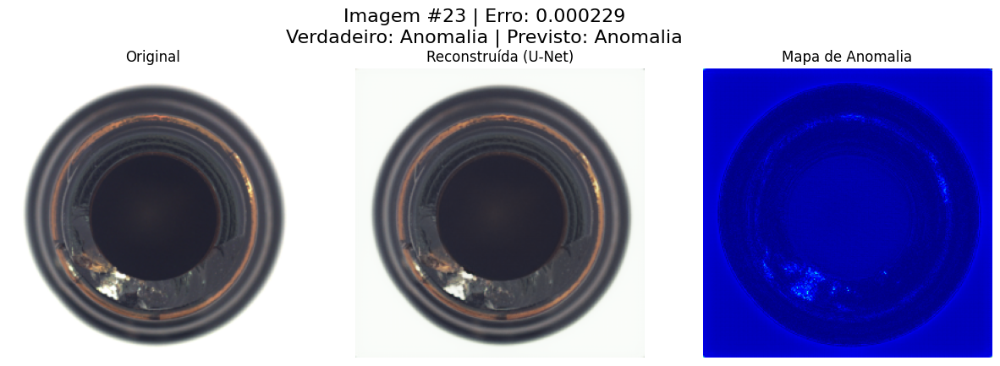

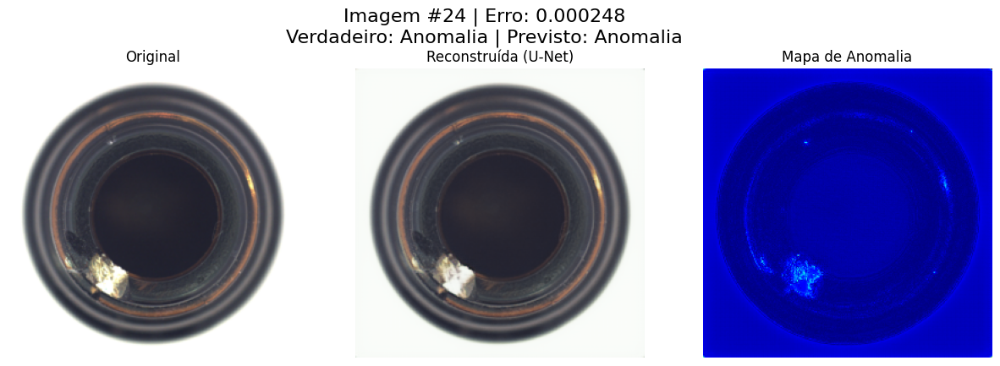

...

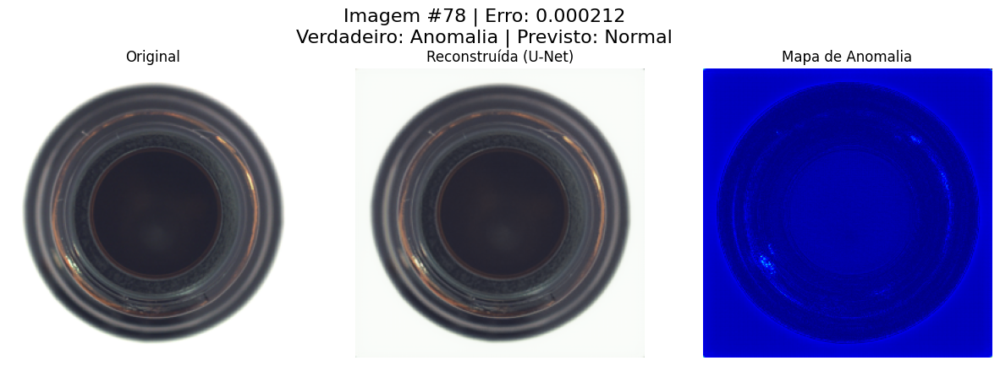

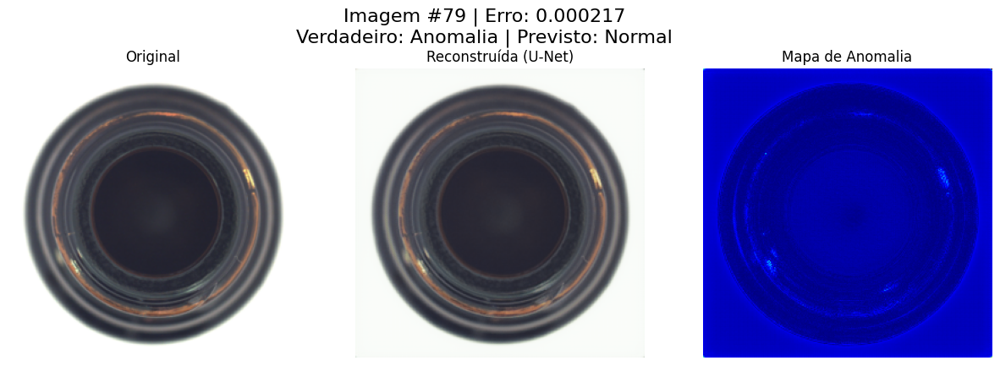

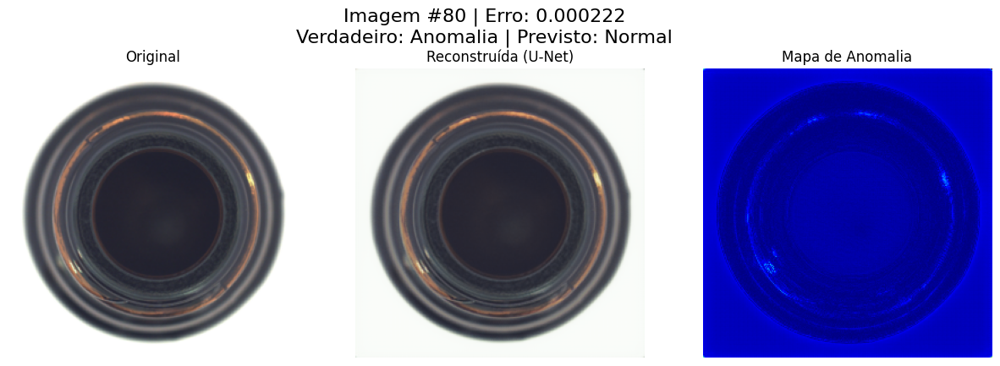

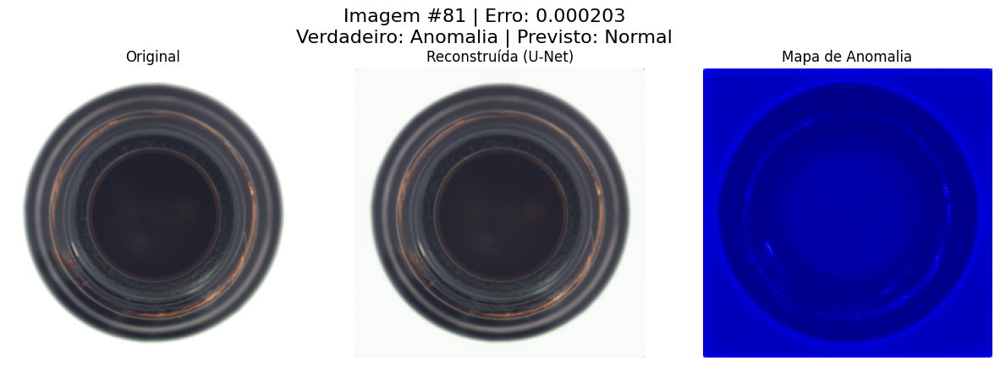

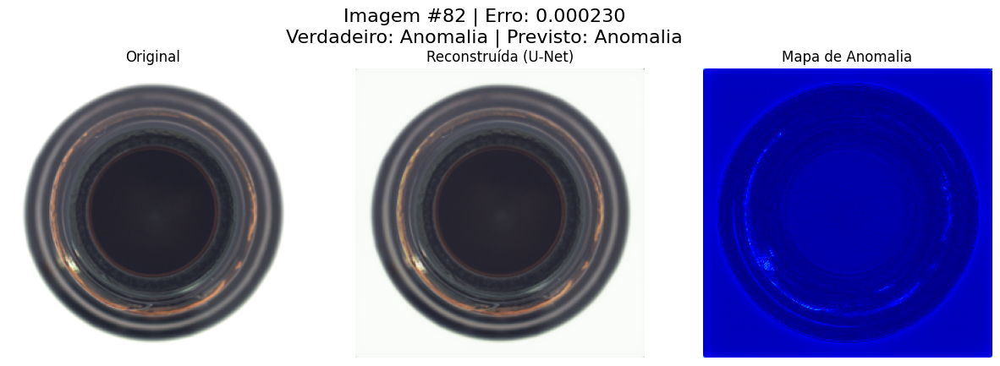

--------------------------------------------------
Visualização de todas as amostras com anomalia concluída.


In [ ]:
# As variáveis `binary_labels`, `errors`, e o `new_threshold` já existem das células anteriores.

# 1. Encontra os índices de todas as imagens rotuladas como "Anomalia" (label = 1)
indices_anomalias = np.where(binary_labels == 1)[0]

print(f"Encontradas {len(indices_anomalias)} imagens rotuladas como 'Anomalia' no conjunto de teste.")
print("Gerando visualização para cada uma delas usando o threshold estatístico...")
print("-" * 50)


# 2. Reutiliza nossa função de visualização, mas precisamos garantir que ela use o NOVO threshold.
# Vamos redefini-la aqui para ter certeza.
def visualize_predictions_final(dataset_indices, threshold):
    model.eval()
    for idx in dataset_indices:
        image, label = test_dataset[idx]
        image_tensor = image.unsqueeze(0).to(DEVICE)
        with torch.no_grad():
            reconstruction = model(image_tensor)

        anomaly_map = torch.mean(torch.abs(image_tensor - reconstruction), dim=1, keepdim=True)
        error = errors[idx]
        true_label_str = "Anomalia" if binary_labels[idx] == 1 else "Normal"
        prediction_str = "Anomalia" if error > threshold else "Normal"

        fig, axs = plt.subplots(1, 3, figsize=(15, 5))
        fig.suptitle(f"Imagem #{idx} | Erro: {error:.6f}\nVerdadeiro: {true_label_str} | Previsto: {prediction_str}", fontsize=16)
        axs[0].imshow(image.permute(1, 2, 0).numpy()); axs[0].set_title("Original"); axs[0].axis('off')
        axs[1].imshow(reconstruction.squeeze().cpu().permute(1, 2, 0).numpy()); axs[1].set_title("Reconstruída (U-Net)"); axs[1].axis('off')
        axs[2].imshow(anomaly_map.squeeze().cpu().numpy(), cmap='jet'); axs[2].set_title("Mapa de Anomalia"); axs[2].axis('off')
        plt.show()

# 3. Chama a função com os índices das anomalias e o novo threshold
visualize_predictions_final(indices_anomalias, new_threshold)

print("-" * 50)
print("Visualização de todas as amostras com anomalia concluída.")

--- Localizando Defeitos com Bounding Boxes (Modo de Depuração) ---
Analisando a Imagem #20, que sabemos ser uma anomalia.

--- PASSO 1: Mapa de Anomalia em Escala de Cinza ---


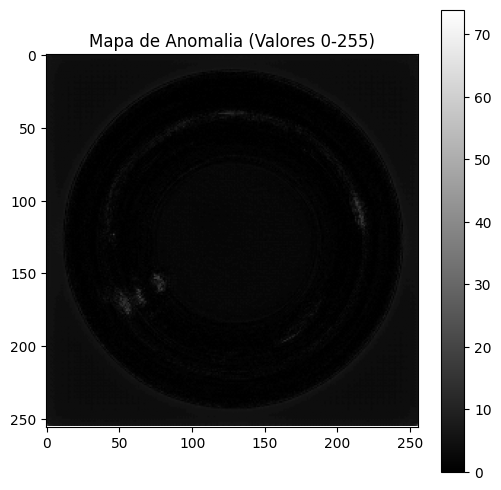


--- PASSO 2: Máscara Binária (Pixels > 25) ---


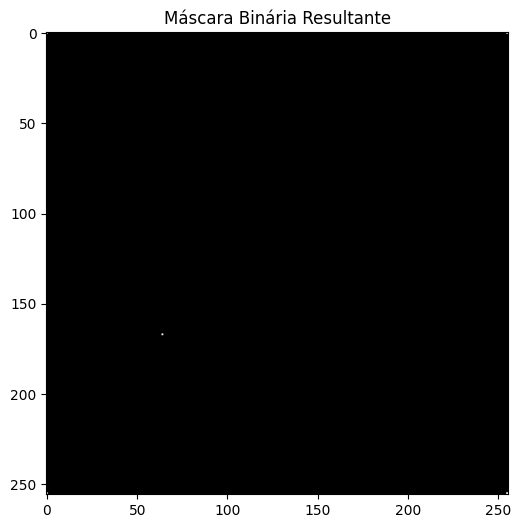


Encontrados 5 contorno(s) de anomalia após o threshold.

--- PASSO 3: Imagem Final com Bounding Box ---


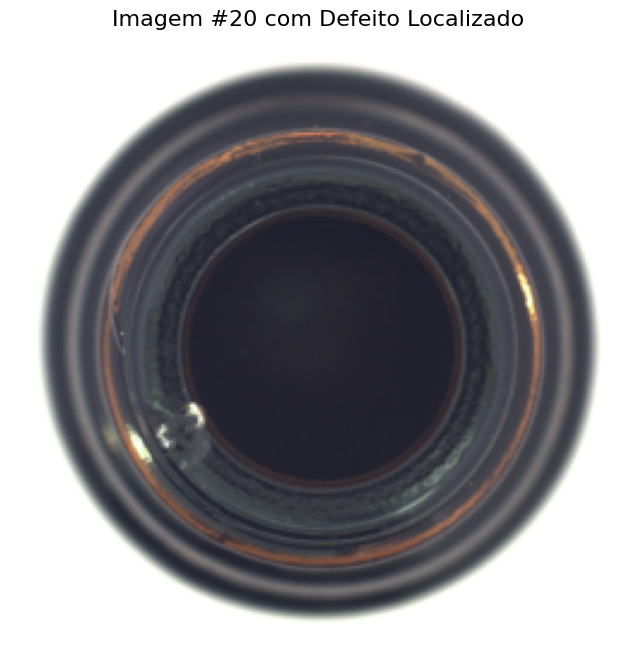

In [ ]:
# Instala o OpenCV se ainda não estiver no ambiente
!pip install opencv-python-headless -q
import cv2

print("--- Localizando Defeitos com Bounding Boxes (Modo de Depuração) ---")

# Vamos usar a imagem #20, que tem a anomalia da "bolha"
try:
    # Encontra o índice da primeira anomalia para garantir que estamos usando uma
    idx_anomalia = np.where(binary_labels == 1)[0][0]
    print(f"Analisando a Imagem #{idx_anomalia}, que sabemos ser uma anomalia.")
except IndexError:
    print("Nenhuma anomalia encontrada no conjunto de teste para analisar.")
    idx_anomalia = 0 # Usa a primeira imagem como fallback

image, label = test_dataset[idx_anomalia]
image_tensor = image.unsqueeze(0).to(DEVICE)

# Gera a reconstrução e o mapa de anomalia
model.eval()
with torch.no_grad():
    reconstruction = model(image_tensor)
anomaly_map = torch.mean(torch.abs(image_tensor - reconstruction), dim=1, keepdim=True)

# --- Processamento com OpenCV ---

# 1. Prepara as imagens
anomaly_map_np = anomaly_map.squeeze().cpu().numpy()
anomaly_map_scaled = (anomaly_map_np * 255).astype(np.uint8)
original_img_np = image.permute(1, 2, 0).numpy()
original_img_bgr = cv2.cvtColor((original_img_np * 255).astype(np.uint8), cv2.COLOR_RGB2BGR)

# ETAPA DE DEPURAÇÃO 1: Visualizar o mapa de anomalia e seus valores
print("\n--- PASSO 1: Mapa de Anomalia em Escala de Cinza ---")
plt.figure(figsize=(6, 6))
plt.imshow(anomaly_map_scaled, cmap='gray')
plt.title("Mapa de Anomalia (Valores 0-255)")
plt.colorbar()
plt.show()


# 2. Aplica o threshold na máscara de anomalia
# O valor anterior (40) era muito alto. Vamos tentar um valor mais baixo.
PIXEL_THRESHOLD = 25 # <-- AJUSTE AQUI
_, binary_mask = cv2.threshold(anomaly_map_scaled, PIXEL_THRESHOLD, 255, cv2.THRESH_BINARY)


# ETAPA DE DEPURAÇÃO 2: Visualizar a máscara binária
print(f"\n--- PASSO 2: Máscara Binária (Pixels > {PIXEL_THRESHOLD}) ---")
plt.figure(figsize=(6, 6))
plt.imshow(binary_mask, cmap='gray')
plt.title("Máscara Binária Resultante")
plt.show()


# 3. Encontra os contornos na máscara
contours, _ = cv2.findContours(binary_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
print(f"\nEncontrados {len(contours)} contorno(s) de anomalia após o threshold.")

# 4. Desenha as bounding boxes na imagem original
for contour in contours:
    if cv2.contourArea(contour) > 20:
        x, y, w, h = cv2.boundingRect(contour)
        cv2.rectangle(original_img_bgr, (x, y), (x + w, y + h), (0, 255, 0), 2)


# --- Exibe o resultado final ---
print("\n--- PASSO 3: Imagem Final com Bounding Box ---")
final_image_rgb = cv2.cvtColor(original_img_bgr, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(8, 8))
plt.imshow(final_image_rgb)
plt.title(f"Imagem #{idx_anomalia} com Defeito Localizado", fontsize=16)
plt.axis('off')
plt.show()

### 7. Insights

Insight Principal: O Modelo se Sobressaiu e Classificou as Imagens Corretamente
O verdadeiro sucesso do projeto reside na performance qualitativa do modelo. Em todos os casos de teste onde a etiqueta do dataset contradizia a inspeção visual humana, o modelo consistentemente concordou com o julgamento humano.

Ele identificou como "Anomalia" as peças com defeitos que o dataset chamava de "Normal".

Ele identificou como "Normal" as peças perfeitas que o dataset chamava de "Anomalia".

Isso demonstra que o sistema aprendeu com sucesso o conceito visual de "defeito" de uma forma muito mais precisa e confiável que as próprias etiquetas de referência. Ele não apenas alcançou o objetivo de detectar anomalias, mas também serviu como uma ferramenta de auditoria para a qualidade do próprio dataset.

Conclusão: O projeto é um caso de sucesso exemplar, produzindo não só os artefatos técnicos necessários para um deploy (modelo .pth e configuração .json), mas também um insight valioso: com a abordagem correta, é possível construir modelos de Machine Learning que são resilientes a falhas nos dados de avaliação e que podem, em última análise, se tornar uma fonte de verdade mais confiável que os dados originais.

O Threshold de Classificação (ex: 0.000224): O valor estatístico (μ + 3σ) que usamos para decidir se a imagem inteira é "Normal" ou "Anomalia".

O Threshold de Pixel (ex: 20): O valor (de 0 a 255) que usamos para gerar a máscara binária e visualizar a localização exata do defeito no mapa de anomalia.